In [1]:
import dotenv
import bluequbit
from qiskit import QuantumCircuit
from qiskit.visualization import plot_state_city

In [2]:
TOKEN = dotenv.dotenv_values(".env")["TOKEN"]

In [3]:
qc = QuantumCircuit.from_qasm_file('quasms\P4_golden_mountain.qasm')

<>:1: SyntaxWarning: invalid escape sequence '\P'
<>:1: SyntaxWarning: invalid escape sequence '\P'
C:\Users\danie\AppData\Local\Temp\ipykernel_11900\153965871.py:1: SyntaxWarning: invalid escape sequence '\P'
  qc = QuantumCircuit.from_qasm_file('quasms\P4_golden_mountain.qasm')


In [4]:
qc.draw('mpl', filename='circuits/P4.png')

## definiendo observables

In [5]:
from qiskit.quantum_info import SparsePauliOp
import numpy as np

In [6]:
num_qubits = 48
pauli_list = []
coeffs = []

In [7]:
# Ejemplo: definir M_z = Z_0 + Z_1 + ... + Z_47
for i in range(num_qubits):
    # Construimos un string de 48 caracteres que sea 'I' en todos lados,
    # y 'Z' solamente en la posición i.
    pauli_str = ['I'] * num_qubits
    pauli_str[i] = 'Z'
    pauli_list.append(''.join(pauli_str))
    coeffs.append(3.08)  # o el coeficiente que corresponda

In [10]:
# Ejemplo de interacciones entre qubits vecinos (si el sistema tiene esta topología)
for i in range(num_qubits - 1):
    pauli_str = ['I'] * num_qubits
    pauli_str[i] = 'Z'
    pauli_str[i + 1] = 'Z'
    pauli_list.append(''.join(pauli_str))
    coeffs.append(-3.08)

In [12]:
observable = SparsePauliOp(pauli_list, coeffs=np.array(coeffs))

In [13]:
print("Observable para 48 qubits:")
print(observable)

Observable para 48 qubits:
SparsePauliOp(['ZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII', 'IZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII', 'IIZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII', 'IIIZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII', 'IIIIZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII', 'IIIIIZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII', 'IIIIIIZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII', 'IIIIIIIZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII', 'IIIIIIIIZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII', 'IIIIIIIIIZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII', 'IIIIIIIIIIZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII', 'IIIIIIIIIIIZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII', 'IIIIIIIIIIIIZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII', 'IIIIIIIIIIIIIZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII', 'IIIIIIIIIIIIIIZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII', 'IIIIIIIIIIIIIIIZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII', 'IIIIIIIIIIIIIIIIZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII', 'IIIIIIIIIIIIIIIIIZIIIIIIIIIIIIIIIIIIIIIIIIIIIIII', 'IIIIIIIIIIIIIIIIIIZII

### Optimizando

In [14]:
from qiskit_addon_cutting.automated_cut_finding import (
    find_cuts,
    OptimizationParameters,
    DeviceConstraints,
)

In [15]:
# Specify settings for the cut-finding optimizer
optimization_settings = OptimizationParameters(seed=111)

# Specify the size of the QPUs available
device_constraints = DeviceConstraints(qubits_per_subcircuit=34)

In [16]:
cut_circuit, metadata = find_cuts(qc, optimization_settings, device_constraints)
print(
    f'Found solution using {len(metadata["cuts"])} cuts with a sampling '
    f'overhead of {metadata["sampling_overhead"]}.\n'
    f'Lowest cost solution found: {metadata["minimum_reached"]}.'
)

Found solution using 213 cuts with a sampling overhead of 1.7933064502448814e+203.
Lowest cost solution found: False.


In [17]:
for cut in metadata["cuts"]:
    print(f"{cut[0]} at circuit instruction index {cut[1]}")
cut_circuit.draw("mpl", scale=0.8, fold=-1)

Gate Cut at circuit instruction index 959
Gate Cut at circuit instruction index 962
Gate Cut at circuit instruction index 1079
Gate Cut at circuit instruction index 1082
Gate Cut at circuit instruction index 1205
Gate Cut at circuit instruction index 1208
Gate Cut at circuit instruction index 1337
Gate Cut at circuit instruction index 1340
Gate Cut at circuit instruction index 1475
Gate Cut at circuit instruction index 1478
Gate Cut at circuit instruction index 1619
Gate Cut at circuit instruction index 1622
Gate Cut at circuit instruction index 1769
Gate Cut at circuit instruction index 1772
Gate Cut at circuit instruction index 1848
Gate Cut at circuit instruction index 1851
Gate Cut at circuit instruction index 2057
Gate Cut at circuit instruction index 2060
Gate Cut at circuit instruction index 2136
Gate Cut at circuit instruction index 2139
Gate Cut at circuit instruction index 2345
Gate Cut at circuit instruction index 2348
Gate Cut at circuit instruction index 2424
Gate Cut at c

### Adicionando los observables 

In [18]:
from qiskit_addon_cutting import cut_wires, expand_observables

In [19]:
qc_w_ancilla = cut_wires(cut_circuit)

In [20]:
observables_expanded = expand_observables(observable.paulis, qc, qc_w_ancilla)

In [21]:
qc_w_ancilla.draw("mpl", scale=0.8, fold=-1)

In [22]:
from qiskit_addon_cutting import partition_problem

partitioned_problem = partition_problem(
    circuit=qc_w_ancilla, observables=observables_expanded
)

In [23]:
subcircuits = partitioned_problem.subcircuits
subobservables = partitioned_problem.subobservables

In [24]:
print(
    f"Sampling overhead: {np.prod([basis.overhead for basis in partitioned_problem.bases])}"
)

Sampling overhead: 1.793306450244881e+203


In [25]:
subobservables

{0: PauliList(['IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'IIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'ZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'IZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'IIZIIIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'IIIZIIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'IIIIZIIIIIIIIIIIIIIIIIIIIIIIIIIIII',
            'IIIIIZIIIIIIIIIIIIIIIIIIIIIIIIIIII

In [27]:
subcircuits[0].draw("mpl", style="iqp", scale=0.8, fold=-1, filename="circuits/subcircuit_0.png")

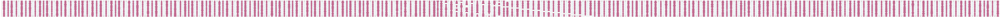

In [28]:
subcircuits[1].draw("mpl", style="iqp", scale=0.8, fold=-1, filename="circuits/subcircuit_1.png")

### Experimentacion

In [29]:
from qiskit_addon_cutting import generate_cutting_experiments

In [30]:
subexperiments, coefficients = generate_cutting_experiments(
    circuits=subcircuits, observables=subobservables, num_samples=1_000
)

In [31]:
print(
    f"{len(subexperiments[0]) + len(subexperiments[1])} total subexperiments to run on backend."
)

2000 total subexperiments to run on backend.


In [32]:
c1 = subcircuits[0].copy()

In [33]:
c2 = subcircuits[1].copy()

### Transpile work

In [ ]:
from qiskit_ibm_runtime.fake_provider import FakeManilaV2

backend = FakeManilaV2()

TypeError: FakeBackendV2.__init__() got an unexpected keyword argument 'num_qubits'

In [46]:

from qiskit.providers.basic_provider import BasicSimulator
from qiskit.transpiler import generate_preset_pass_manager

# Use a simulator backend that supports larger circuits
sim_backend = BasicSimulator()

# Transpile the subexperiments to ISA circuits using the simulation backend
pass_manager = generate_preset_pass_manager(optimization_level=1, backend=sim_backend)
isa_subexperiments = {
    label: [pass_manager.run(circ) for circ in partition_subexpts]
    for label, partition_subexpts in subexperiments.items()
}

In [56]:
for label, subexpts in isa_subexperiments.items():
    print("Label:", label)
    print("Type:", type(subexpts))
    if isinstance(subexpts, list):
        for sc in subexpts:
            print("  Subcircuit qubits:", sc.num_qubits)
    else:
        # Quizá sea un único circuito
        print("  Subcircuit qubits:", subexpts.num_qubits)


Label: 0
Type: <class 'list'>
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircuit qubits: 34
  Subcircu

In [75]:
from qiskit import transpile
job = backend.run(isa_subexperiments[0], shots=364)

### Job worker

In [37]:
bq = bluequbit.init(TOKEN) # <-- BlueQubit Magic

[BQ-PYTHON-SDK][WARNING] - Beta version 0.12.0b1 of BlueQubit Python SDK is being used.


In [ ]:
subcircuits_decom = [cq.decompose(reps=1024) for cq in subcircuits.values()]

In [87]:
from qiskit.qasm2 import dumps
for idx, qc in enumerate(subcircuits_decom):
    qasm_str = dumps(qc)
    filename = f"subcircuito_{idx}.qasm"
    with open(filename, "w") as file:
        file.write(qasm_str)
    print(f"Subcircuito {idx} guardado en {filename}")

Subcircuito 0 guardado en subcircuito_0.qasm
Subcircuito 1 guardado en subcircuito_1.qasm


In [77]:
# Run at most 500 circuits to stay within the batch job limit
job1 = bq.run(c1, job_name="P4 subcircuit_0", shots=500, device="cpu")

BQJobNotCompleteError: Job rTiP2UffARdRZi48 finished with status: FAILED_VALIDATION. Qiskit transpile error: <class 'qiskit.transpiler.exceptions.TranspilerError'>: "HighLevelSynthesis was unable to synthesize Instruction(name='qpd_1q', num_qubits=1, num_clbits=0, params=[])."